**Applied Data Science Capstone**

**Pittsburgh Neighborhood Breakdown**

*Brain Feldman*

Introduction
Pittsburgh has been rapidly reinventing its image into a technology and medical metropolitian area from its previous previous roots as an industrial center.  As these industries change the city, so does the population demographics.  As more people move to the city, many are unfamiliar with what the surrounding neighborhoods and risk moving somewhere that is not in line with thier interests.

This analysis and report can be used to identify neighborhoods in and around the city of Pittsburgh by what type of services they offer to help people decide where to move.  The findings in this report can also be used current residents of the city to see what areas are best for different types of activities.


**This notebook uses Python to import and evaluate the following data**
* Import and locate the different boroughs within Allegheny County
* Gather and locate the venues near each borough from the Foursquare API
* Develop a comparison graph for each category showing the best and worst neighborhoods

**Data**

* Allegheny County Neighborhoods: http://citypopulation.de/php/usa-pennsylvania.php?adm2id=42003

This site included a list of all of the neighborhoods in Pittsburgh which looks at the population from each neighborhood.  For this analysis I will only be using the Name of each neighborhood.  Additionally, the neighborhood 'Liberty' was removed as the geographical coordinates could not be found.

* Pittsburgh Venue Information: Foursquare API

This contains a list of all of the businesses / venues within Pittsburgh and is associated to each neighborhood based on coordinate proximity.



**Methodology**

* Exploratory Data Analysis

Through these two data sources most of the necessary information was retrievable.  Through the Allegheny County Neighborhoods site, the coordinates for the neighborhood "Liberty" were unavailable.  This neighborhood was removed.  There were also some smaller neighborhoods that were not listed in the data set which were not added from another source.

* Inferential Statistical Testing

Inferential statistical testing was not needed in this assessment as there was no recommendation provided to an end user.  This evaluation was meant to offer a comparison report for what each neighborhood had a comparative in against the general mean.

* Machine Learning Techniques

Currently Foursquare has a total of 8 different categories which, through K Means Clustering, was brought down to 8 distinct category types.  This was chosen over other clustering methods such as DBSCAN since it looks at the general density of the items rather than requiring a minimum number of neighbors to define the cluster.

The 8 Distinct Categories were as follows:
1. Accommodation
2. Bar
3. Cultural
4. Entertainment
5. Fast Food
6. Restaurant
7. Shopping
8. Transport

**Results**

Through analyzing the venue data from Pittsburgh neighborhoods, these are the 8 different clusters and their respective size.





In [14]:
#group venues by Major Category and calculate the quantity nad global means
venues_byMajorCategory = venues_nearby.groupby('Major Category',sort=True).Neighborhood.agg('count').to_frame('Quantity').reset_index()
venues_byMajorCategory['global_mean'] = venues_byMajorCategory.Quantity/venues_byMajorCategory.Quantity.sum()
venues_byMajorCategory

,Major Category,Quantity,global_mean
0,Accomodation,77,0.024100
1,Bar,243,0.076056
2,Cultural,186,0.058216
3,Entertainment,211,0.066041
4,Fast Food,902,0.282316
5,Restaurant,615,0.192488
6,Shopping,851,0.266354
7,Transport,110,0.034429


The venues in Pittsburgh are shown here with their respective cluster in the table below.



In [17]:
#Cluster labels starts at 0 so add 1 and create cluster column to the dataframe and display first 10 rows
venues_nearby['kmeans'] = kmeans.labels_ + 1
venues_nearby.head(10)

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Major Category,kmeans
0,Aspinwall,40.491242,-79.90351,Randita's Organic Vegan Cafe,40.490189,-79.904924,Vegetarian / Vegan Restaurant,Restaurant,3
1,Aspinwall,40.491242,-79.90351,Esspa Kozmetika Organic Skincare,40.489430,-79.901057,Spa,Entertainment,6
2,Aspinwall,40.491242,-79.90351,Labriola's Italian Market,40.488284,-79.898610,Italian Restaurant,Restaurant,3
3,Aspinwall,40.491242,-79.90351,Burgatory,40.489315,-79.892910,Burger Joint,Fast Food,1
4,Aspinwall,40.491242,-79.90351,CC's Café,40.493595,-79.914514,Italian Restaurant,Restaurant,3
5,Aspinwall,40.491242,-79.90351,Aspinwall Beans N Cream,40.489338,-79.900943,Coffee Shop,Fast Food,1
6,Aspinwall,40.491242,-79.90351,Camp Guyasuta,40.496836,-79.910790,Campground,NaN,2
7,Aspinwall,40.491242,-79.90351,Market District Supermarket,40.488268,-79.893739,Supermarket,Shopping,4
8,Aspinwall,40.491242,-79.90351,Highland Park,40.479820,-79.915556,Park,Cultural,7
9,Aspinwall,40.491242,-79.90351,Patty's Farmer's Market,40.488154,-79.897856,Farmers Market,Shopping,4


The mean was then determined for each category type within its neighborhood.


In [19]:
#Calculate neighborhood means for each Major Category in ther neighborhood and display first 15 rows
neighborhood_mean = totalby_Neighborhood.groupby(level=0,sort=False).apply(lambda x: x/float(x.sum()))

df_neighborhood = neighborhood_mean.reset_index()
df_neighborhood = df_neighborhood.rename({'Quantity':'neighborhood_mean'},axis=1)

df_neighborhood.head(15)

,Neighborhood,kmeans,Major Category,neighborhood_mean
0,Aspinwall,1,Fast Food,0.290909
1,Aspinwall,3,Restaurant,0.236364
2,Aspinwall,4,Shopping,0.290909
3,Aspinwall,5,Bar,0.036364
4,Aspinwall,6,Entertainment,0.072727
5,Aspinwall,7,Cultural,0.054545
6,Aspinwall,8,Transport,0.018182
7,Avalon,1,Fast Food,0.272727
8,Avalon,2,Accomodation,0.181818
9,Avalon,3,Restaurant,0.090909


This was then compared to the global mean aggregated for all Pittsburgh neighborhoods and the difference between the two numbers was computed.


In [29]:
#Add Major Category global mean by Major Category using the dictionary created above
df_neighborhood['global_mean'] = df_neighborhood['Major Category'].map(majorCategory_global_dict)

#Calculate the percentage difference between neighborhood mean and global mean, add to the dataframe and display the first 15 rows
df_neighborhood['diff_mean'] = round((df_neighborhood.neighborhood_mean - df_neighborhood.global_mean) * 100,2)

df_neighborhood.head()

,Neighborhood,kmeans,Major Category,neighborhood_mean,global_mean,percent_diff,Difference from Mean,diff_mean
0,Aspinwall,1,Fast Food,0.290909,0.282316,0.86,0.86,0.86
1,Aspinwall,3,Restaurant,0.236364,0.192488,4.39,4.39,4.39
2,Aspinwall,4,Shopping,0.290909,0.266354,2.46,2.46,2.46
3,Aspinwall,5,Bar,0.036364,0.076056,-3.97,-3.97,-3.97
4,Aspinwall,6,Entertainment,0.072727,0.066041,0.67,0.67,0.67


Histograms are used to show the categories each neighborhood has strengths and weaknesses in.  
This is done through differentiating the categories above and below the global mean and ploting them on a histogram.

This analysis will provide a distinction of which categories are best and worst within each neighborhood.

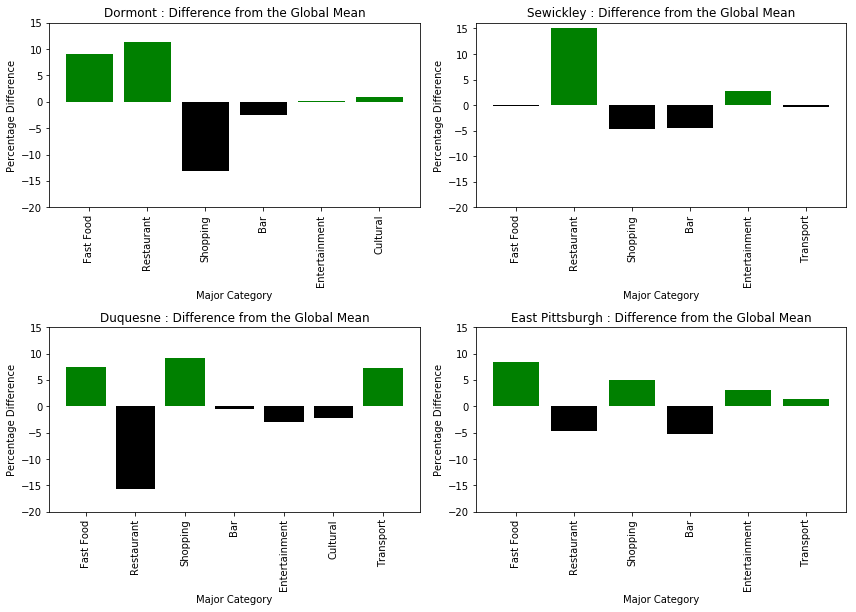

In [27]:
#Select the 4 example neighborhoods and call the plot function
neighborhoods = ['Dormont','Sewickley','Duquesne','East Pittsburgh']

fig = plt.figure(figsize=(12, 20))

for count in range(0,4):
    plot_neighborhood_differences(neighborhoods,count)
fig.tight_layout()
plt.show()

**Results Analysis**

Through plotting the different venues on a map, the strengths of each neighborhood can be identified.  A breakdown of each neighborhood's tactics are listed at the bottom.

In [31]:
#for the 4 example neighborhoods, create and display the map
for neighborhood in neighborhoods:
    latitude = venues_nearby.loc[venues_nearby['Neighborhood'] == neighborhood]['Neighborhood Latitude'].unique()[0]
    longitude = venues_nearby.loc[venues_nearby['Neighborhood'] == neighborhood]['Neighborhood Longitude'].unique()[0]
    create_map(latitude,longitude)

**Dormont**

Dormont has about 10% the global average with both fast food and restaurants.  People interested in having a greater food selection would enjoy this neighborhood.  
Due to the higher incidence of fast food, some of the restaurants may be focused more on the lower end of the price spectrum.

Shopping is about 15% lower than the global mean so this neighborhood would not be ideal for people who enjoy shopping.

**Swickley**

Swickley has a 15% higher presence of restaurants than the global average while falling within 5% of the average for each of the other categtories.

Since most of the businesses in this neighborhood seem to be centered around a main area, there is likely a vibrant downtown area with more high end stores and restaurants.

**Duquesne**

Duquesne is above the global mean in fast food, shopping, and transport.  This makes it appear as if the neighborhood is a downtown hub for a lower end neighborhood, but upon inspection of the map it is near an amusement park.  Many of the food stands at the amusement park are considered fast food and therefore skew the results of this neighborhood.

**East Pittsburgh**

East Pittsburgh is above the global mean in fast food (7%), shopping (5%), and entertainment (3%).  This shows the neighborhood is likely close to a cultural hub of the city.  Additionally, based on the map, it is close to many other neighborhoods with other venues that may influence its cluster types.